In [1]:
import os
import numpy as np
import tifffile as tiff
import matplotlib.pyplot as plt
import cv2
import math
import pandas as pd
from CSL_2025_Python_codes import spim2XYZ, XYZ2Lab, spim2rgb, XYZ2RGB
from functions import *

1. Load Spectral Reflectances Cubes


In [2]:
# Define parameters
# Wether we want to use initial samples (False) or test samples (True)
test = True

# The test trial (1 or 2)
trial = 1

# The operator (1 or 2 or 3)
operator = 2

In [3]:
# Define folder path

dark_folder = "dark"
white_folder = "white"

if test:
    base_folder = "../IDP Group A/test" + str(trial) + "/operator" + str(operator)
    reference_folder = (
        "../IDP Group A/test" + str(trial) + "/operator" + str(operator) + "/reference"
    )  # reference is always the same? --> no
    if trial == 1:
        sample_folders = [
            "d3",
            "d4",
            "d7",
            "d10",
            "d12",
            "d13",
            "d18",
            "d19",
            "d20",
            "d21",
            "d22",
        ]
    elif trial == 2:
        sample_folders = [
            "d0",
            "d3",
            "d4",
            "d7",
            "d10",
            "d12",
            "d13",
            "d18",
            "d19",
            "d20",
            "d21",
            "d22",
        ]  # d0 is also reference

else:
    base_folder = "../IDP Group A/train"
    sample_folders = [f"d{i}" for i in range(1, 15)]  # d1 to d14
    reference_folder = "../IDP Group A/train/reference"

# Define wavelength list (450 nm to 950 nm in 20 nm steps)
wavelengths = list(range(450, 951, 20))


# Load white and dark images
def load_cube(folder_path):
    tif_files = [f for f in os.listdir(folder_path) if f.lower().endswith(".tif")]
    tif_files.sort()

    cube = []
    for tif_file in tif_files:
        tif_path = os.path.join(folder_path, tif_file)
        tif = tiff.imread(tif_path)
        cube.append(tif)

    cube = np.array(cube)

    return cube


# Load dark and white reference cubes
dark_cube = load_cube(os.path.join(base_folder, dark_folder))
white_cube = load_cube(os.path.join(base_folder, white_folder))
reference_cube = load_cube(reference_folder)
if test:
    reference_cube = load_cube(base_folder + "/reference")


# Avoid division by zero
denominator = white_cube - dark_cube
denominator[denominator == 0] = 1e-6

# Load and compute reflectance for each sample
defect_cubes = {}

for folder in sample_folders:
    sample_cube = load_cube(os.path.join(base_folder, folder))
    R = (sample_cube - dark_cube) / denominator
    defect_cubes[folder] = R  # Shape: (bands, height, width)

2. Reference


In [4]:
# Get Pixels of IC region

if test == True:
    if trial == 1:
        if operator == 1:
            pixel_IC = (300, 380)
        else:
            pixel_IC = (290, 350)

    elif trial == 2:
        if operator == 1:
            pixel_IC = (200, 380)
        else:
            pixel_IC = (300, 380)
else:
    pixel_IC = (192, 305)

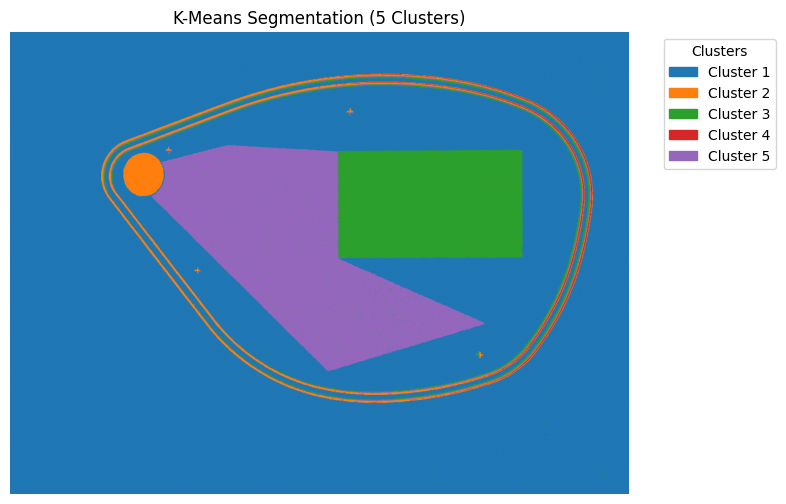

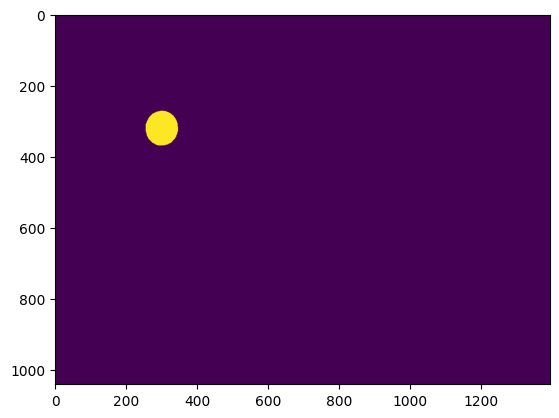

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


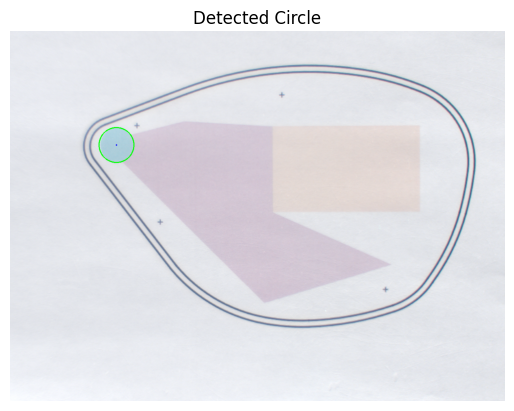

Reflectance shape: (26, 1040, 1392)
RGB shape: (1040, 1392, 3)
Mask shape: (1040, 1392)
Single band shape: (1040, 1392)
Binary shape: (1040, 1392)
circle_info: {'centroid': (299.87682944500796, 320.4177896923151), 'area': 6901.0, 'perimeter': 315.22034442424774, 'min_enclosing_circle': {'center': (299.5, 320.5), 'radius': 49.23931121826172}, 'ellipse': ((299.8938293457031, 320.42529296875), (90.61019134521484, 97.09270477294922), 4.775750637054443), 'circularity': 0.8727571450579918}


In [5]:
R_sample = (reference_cube - dark_cube) / denominator

band = 530  # Band for alignment

R_sample_interp, new_wavelengths = interpolate_spectral_cube(
    R_sample, wavelengths, wl_min=360, wl_max=830, wl_step=10
)
R_sample_interp = np.transpose(R_sample_interp, (1, 2, 0))  # (H, W, bands)

ref_XYZ = spim2XYZ(R_sample_interp, new_wavelengths, "D65")
ref_LAB = XYZ2Lab(ref_XYZ, new_wavelengths, "D65")
ref_rgb = XYZ2RGB(ref_XYZ)

# ref_rgb = spim2rgb(R_sample, wavelengths)
ref_mask = compute_IC_mask(ref_rgb, pixel_IC=pixel_IC)
ref_single_band = R_sample[wavelengths.index(band), :, :]
ref_binary = convert_binary_image(ref_single_band)
ref_circle_info = get_circle_info(ref_mask, ref_rgb, True)
center_pixel = (
    int(ref_circle_info["centroid"][0]),
    int(ref_circle_info["centroid"][1]),
)
# if ref_rgb.dtype != np.uint8:
#     ref_rgb = np.clip(ref_rgb * 255, 0, 255).astype(np.uint8)

circle_center = ref_circle_info["min_enclosing_circle"]["center"]
circle_center = (int(np.round(circle_center[0])), int(np.round(circle_center[1])))
circle_radius = ref_circle_info["min_enclosing_circle"]["radius"]
ref_cropped = crop_circle(ref_rgb, circle_center, circle_radius)
cropped_circles = [ref_cropped]

ref_spectrum = average_reflectance_in_circle(R_sample, circle_center, circle_radius)
spectra = {"reference": ref_spectrum}


mask_ref = np.zeros(ref_LAB.shape[:2], dtype=np.uint8)
cx, cy = int(circle_center[0]), int(circle_center[1])
r = int(circle_radius) - 5
cv2.circle(mask_ref, (cx, cy), r, 1, -1)

ref_cropped = crop_circle(ref_rgb, circle_center, circle_radius)
cropped_circles = [ref_cropped]

print(f"Reflectance shape: {R_sample.shape}")
print(f"RGB shape: {ref_rgb.shape}")
print(f"Mask shape: {ref_mask.shape}")
print(f"Single band shape: {ref_single_band.shape}")
print(f"Binary shape: {ref_binary.shape}")
print(f"circle_info: {ref_circle_info}")

3. Find Homography matrix for the alignment of each defect


Aligning d3...


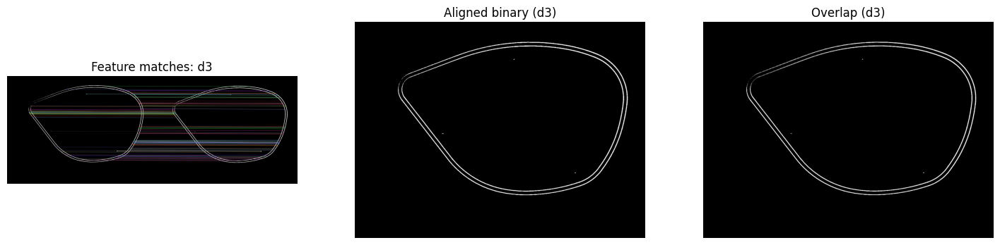

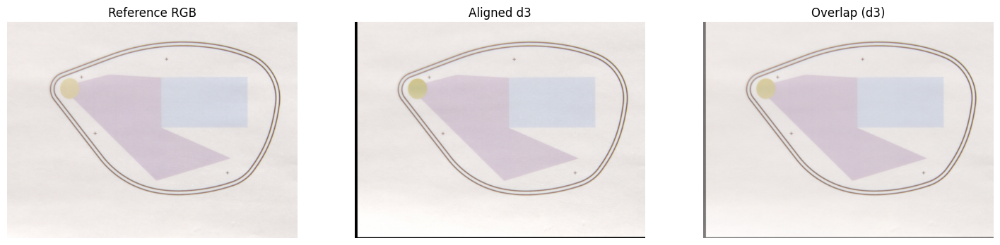

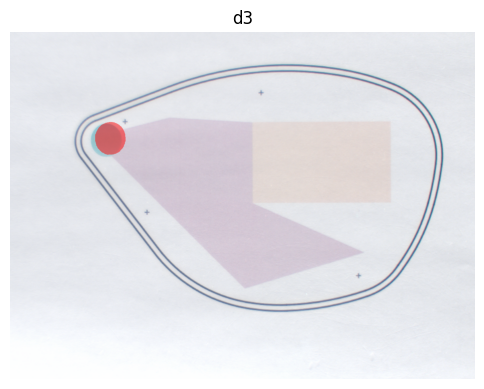

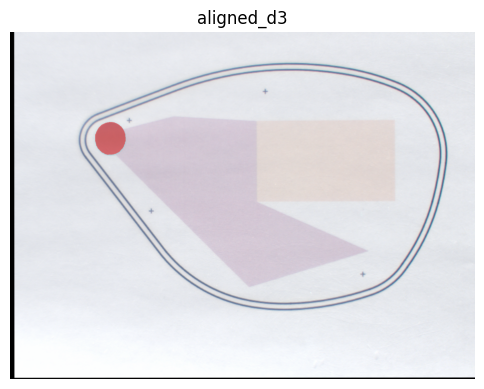

Aligning d4...


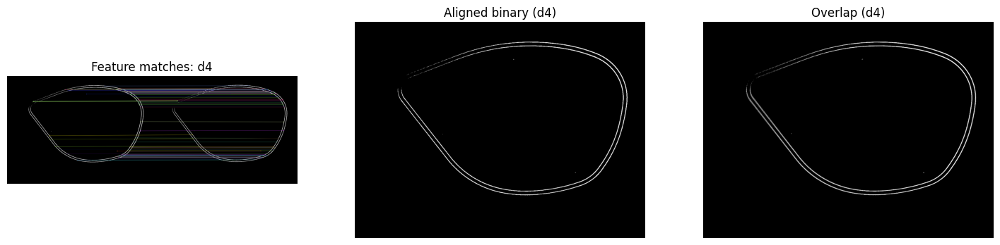

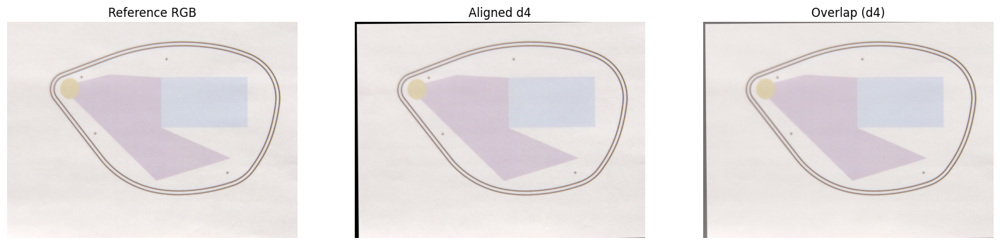

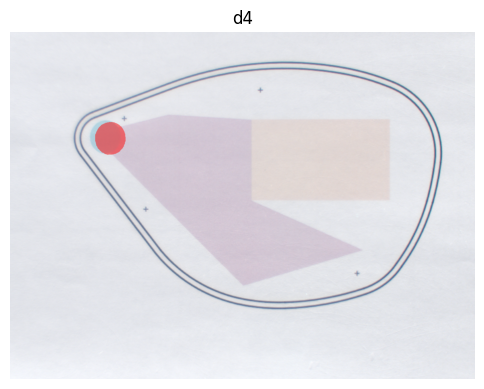

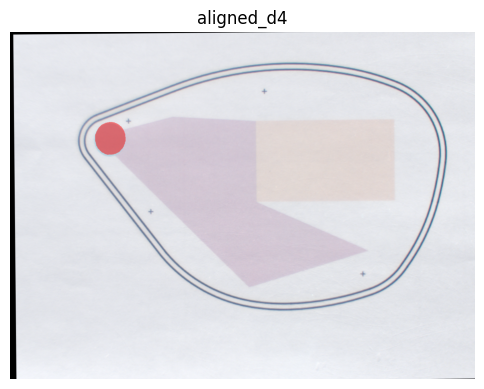

Aligning d7...


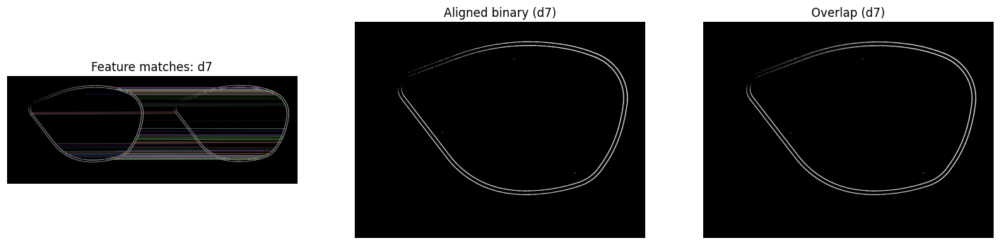

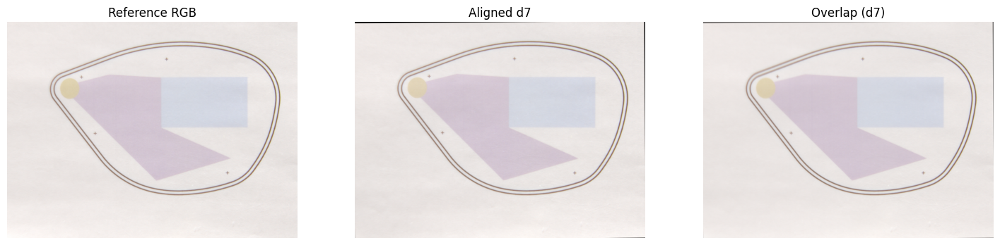

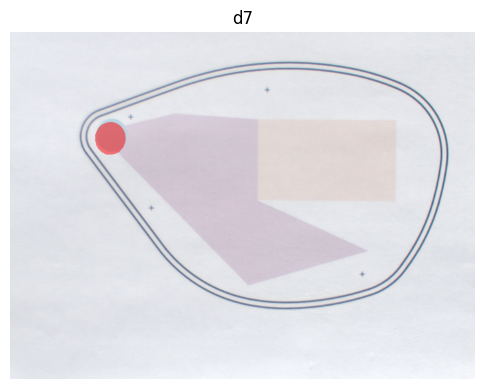

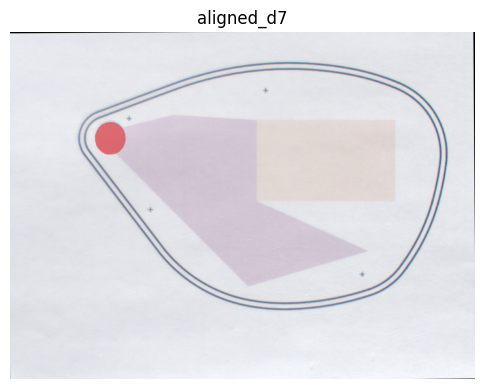

Aligning d10...


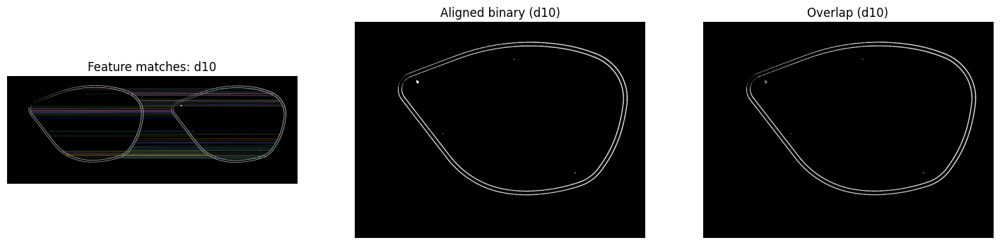

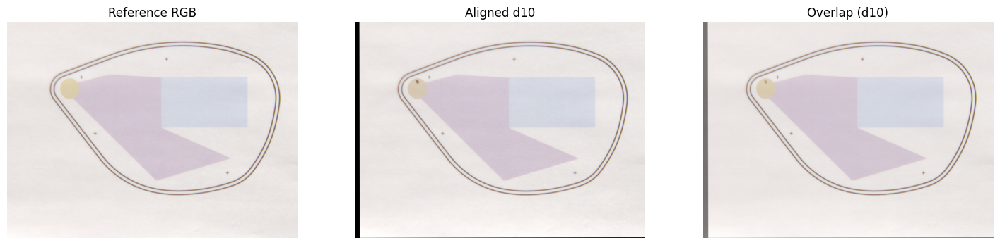

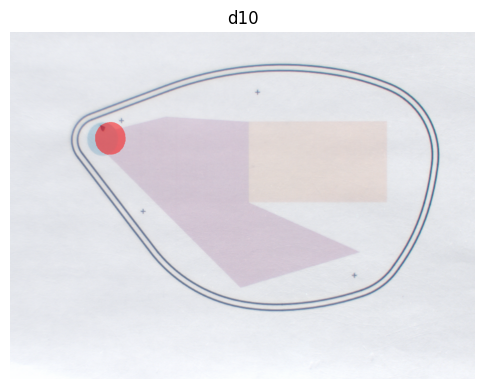

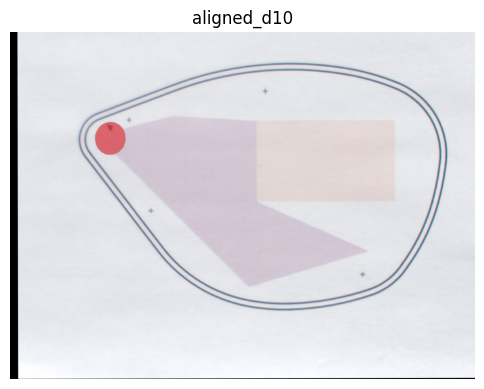

Aligning d12...


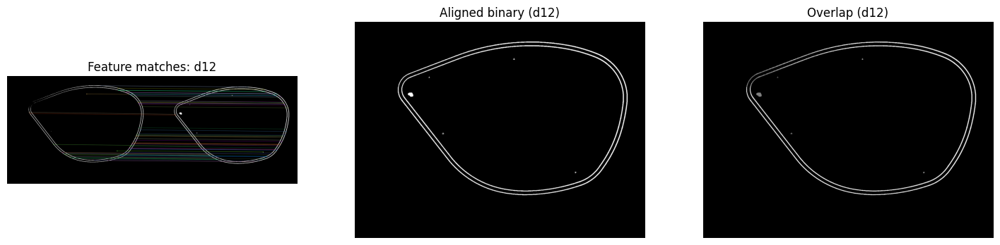

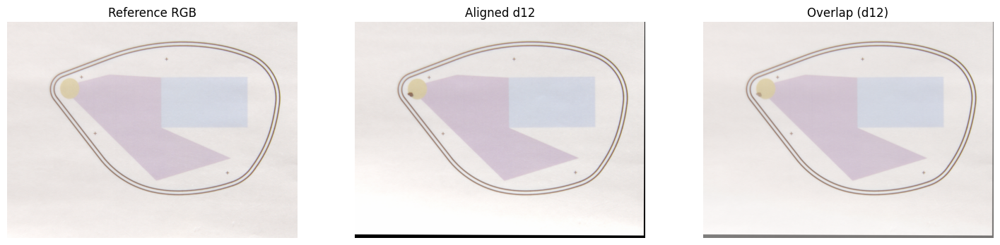

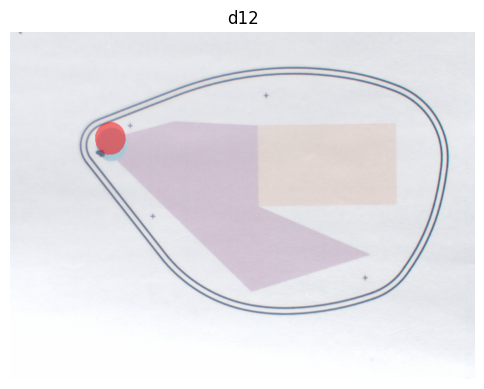

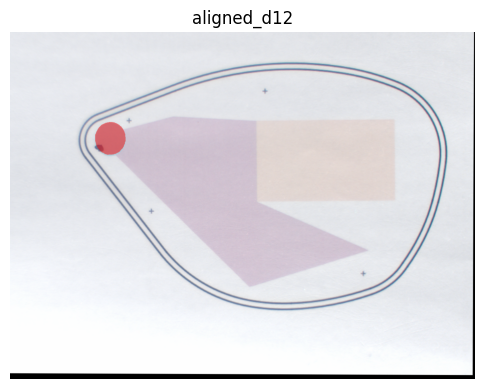

Aligning d13...


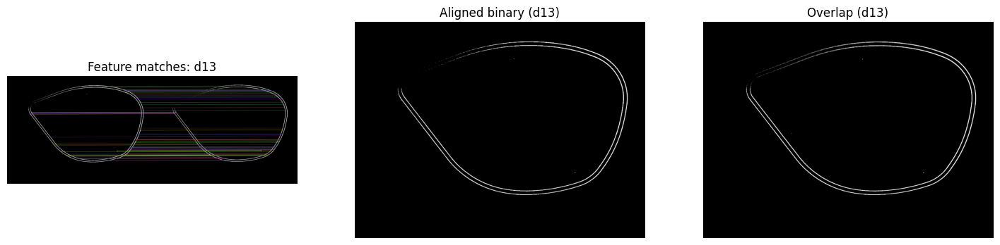

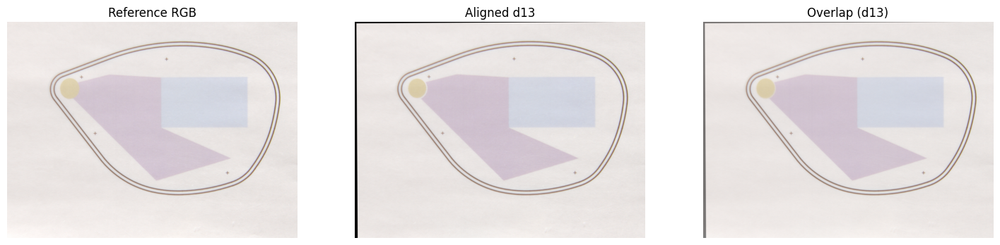

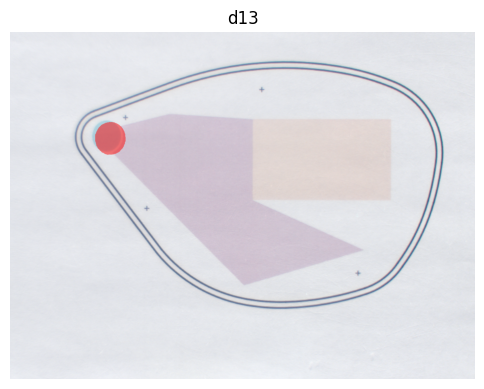

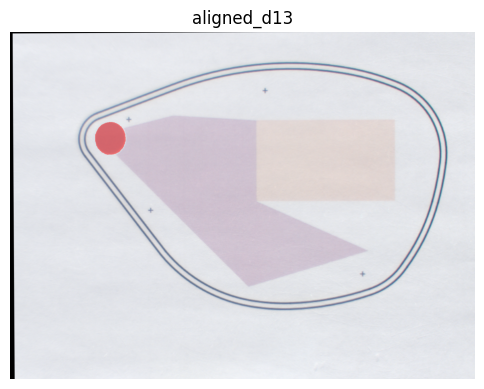

Aligning d18...


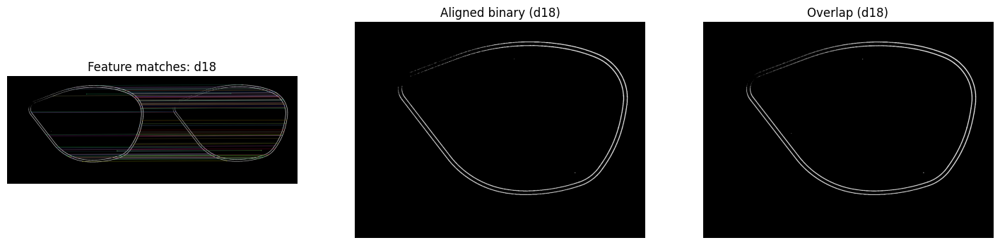

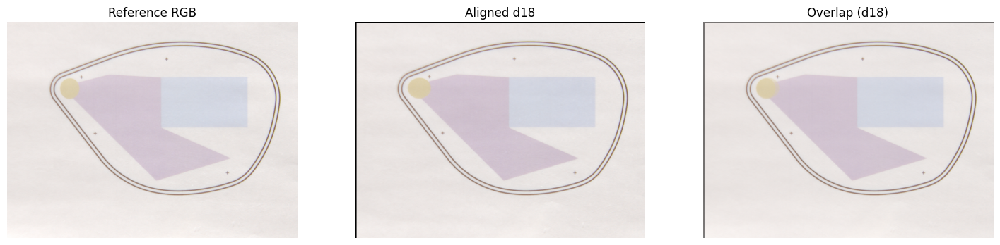

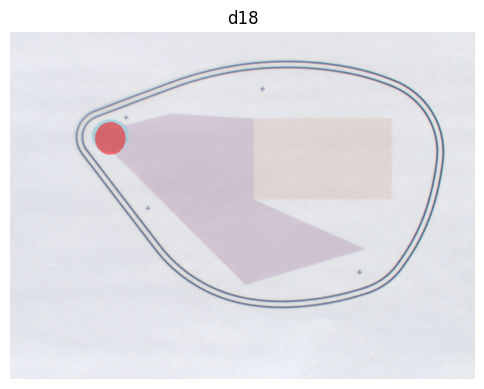

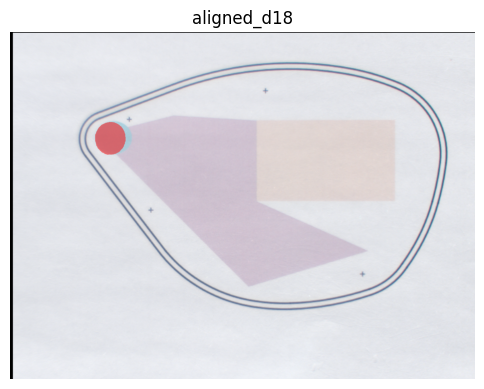

Aligning d19...


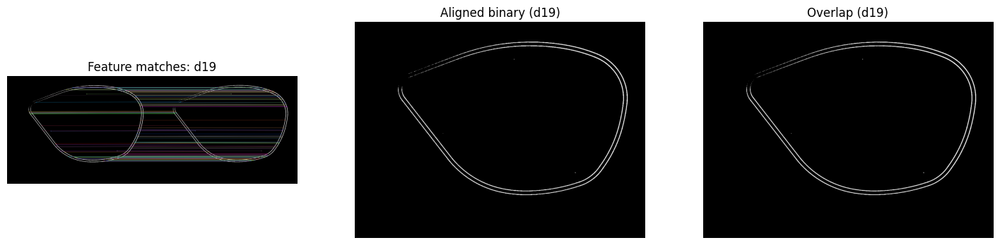

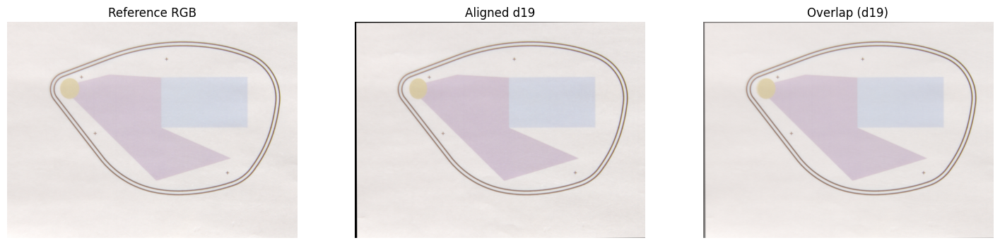

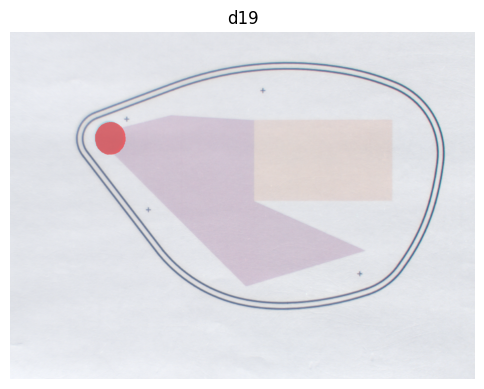

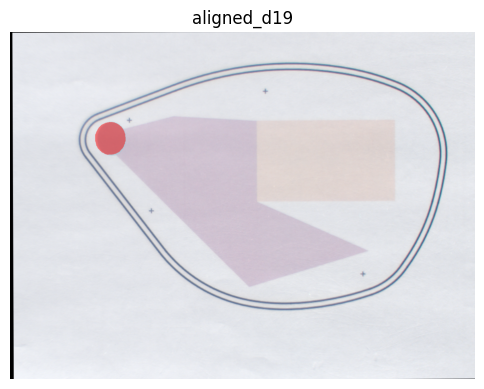

Aligning d20...


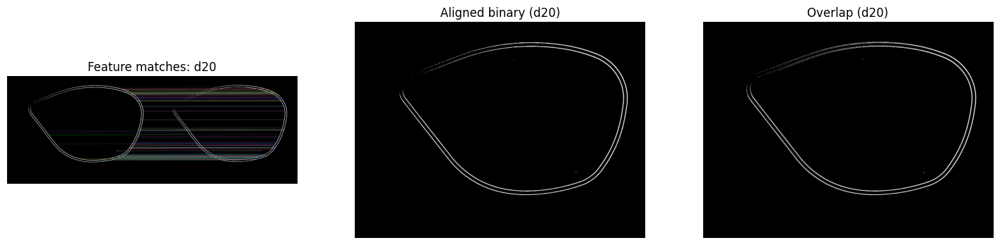

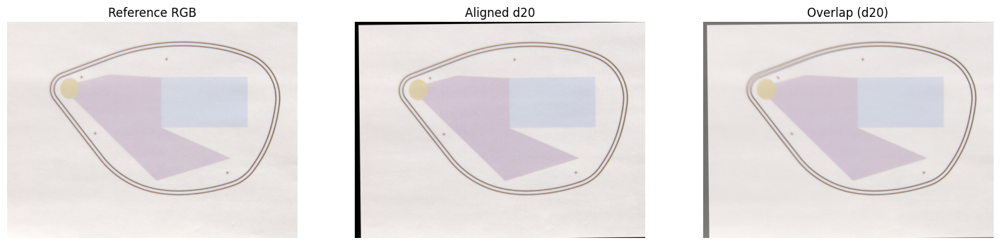

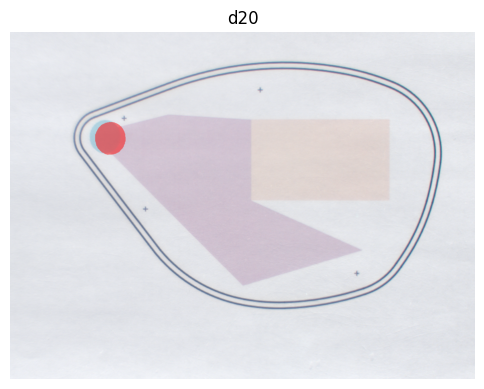

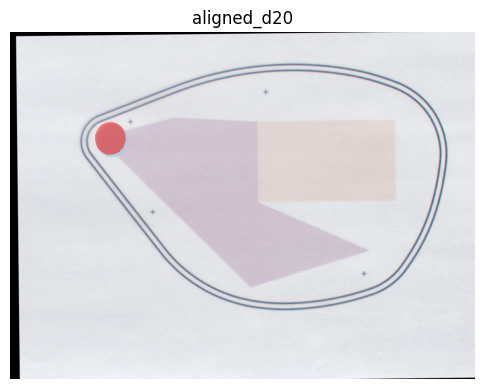

Aligning d21...


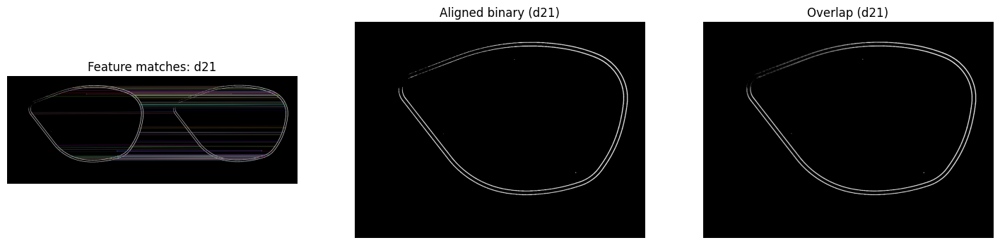

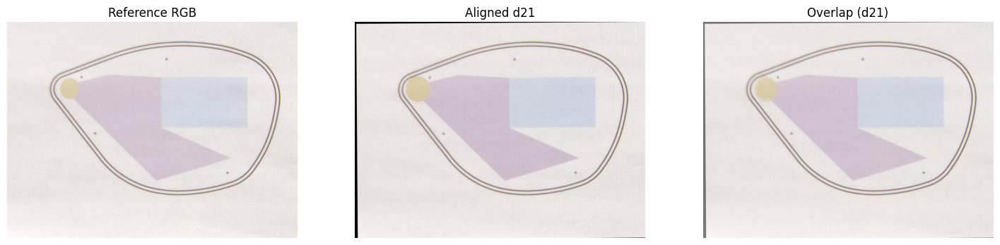

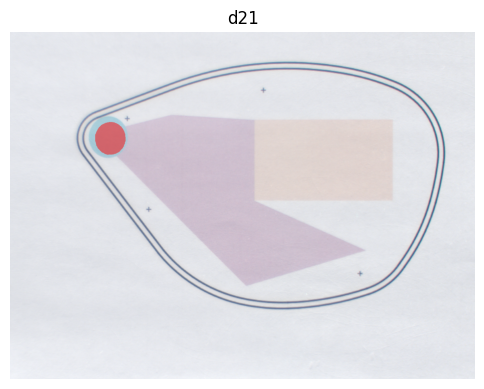

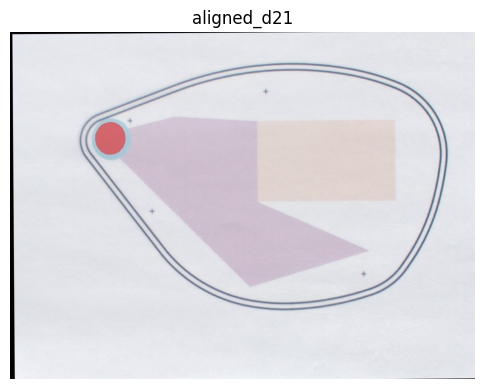

Aligning d22...


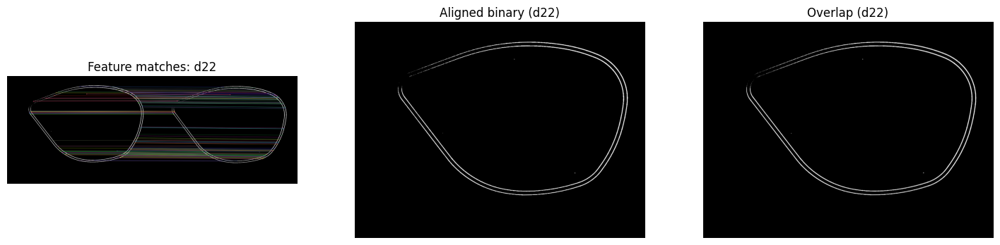

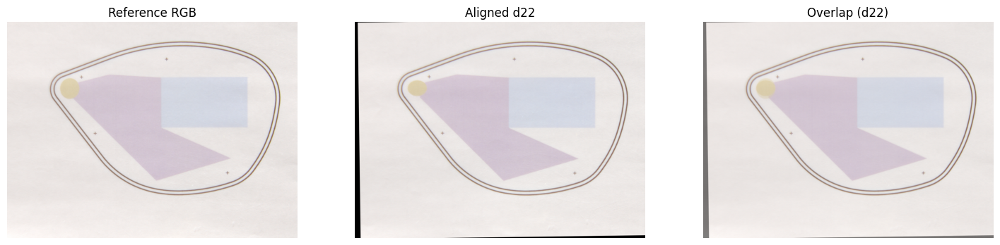

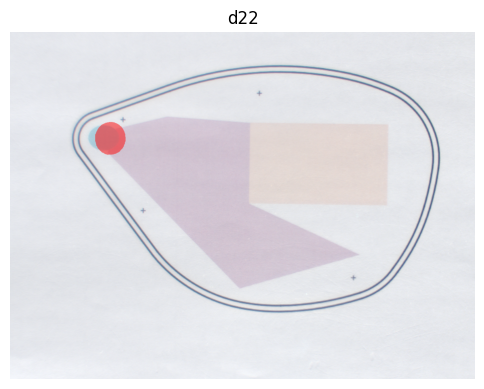

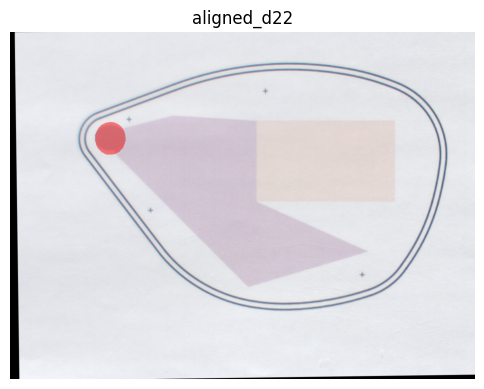

In [6]:
defect_homographies = []
defects = sample_folders
for defect in defects:
    print(f"Aligning {defect}...")

    # Spectral to XYZ to LAB
    cube_interp, _ = interpolate_spectral_cube(
        defect_cubes[defect], wavelengths, wl_min=360, wl_max=830, wl_step=10
    )
    cube_interp = np.transpose(cube_interp, (1, 2, 0))  # (H, W, b)

    def_XYZ = spim2XYZ(cube_interp, new_wavelengths, "D65")
    defect_rgb = XYZ2RGB(def_XYZ)

    # defect_rgb = spim2rgb(defect_cubes[defect], wavelengths)
    defect_binary = convert_binary_image(
        get_example_reflectance(defect_cubes, defect, band)
    )
    H = align_and_visualise_homography(
        ref_binary, defect_binary, defect, visualise=True
    )
    defect_homographies.append(H)

    if ref_rgb.dtype != np.uint8:
        ref_rgb = np.clip(ref_rgb * 255, 0, 255).astype(np.uint8)
    if defect_rgb.dtype != np.uint8:
        defect_rgb = np.clip(defect_rgb * 255, 0, 255).astype(np.uint8)

    aligned_defect, blended = align_and_blend_RGB_homography(
        ref_rgb, defect_rgb, H, defect
    )
    overlay_mask(defect_rgb, ref_mask, defect, color=(1, 0, 0), alpha=0.5)
    overlay_mask(
        aligned_defect, ref_mask, f"aligned_{defect}", color=(1, 0, 0), alpha=0.5
    )

4. CTQs without allignment


5. Compute CTQs for all defects


Processing d3...
[[ 9.99825285e-01  7.21796761e-04  1.25239583e+01]
 [-7.21796761e-04  9.99825285e-01 -3.38769139e+00]]


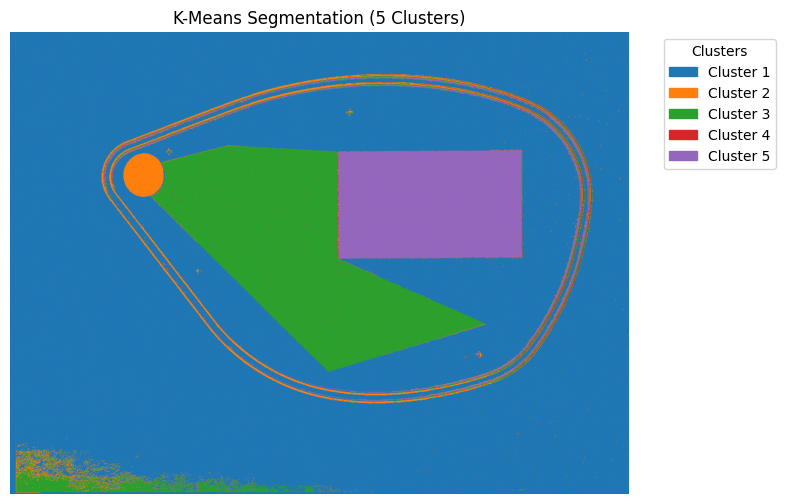

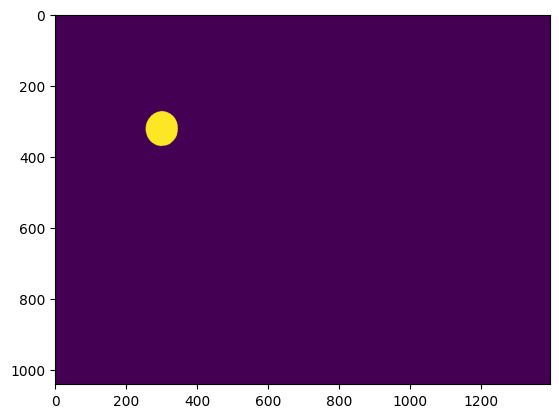

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


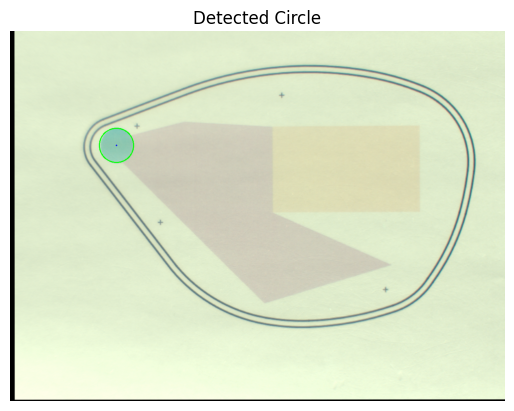

Processing d4...
[[ 1.00083496e+00  9.26081346e-03  9.76137183e+00]
 [-9.26081346e-03  1.00083496e+00  1.05735095e+01]]


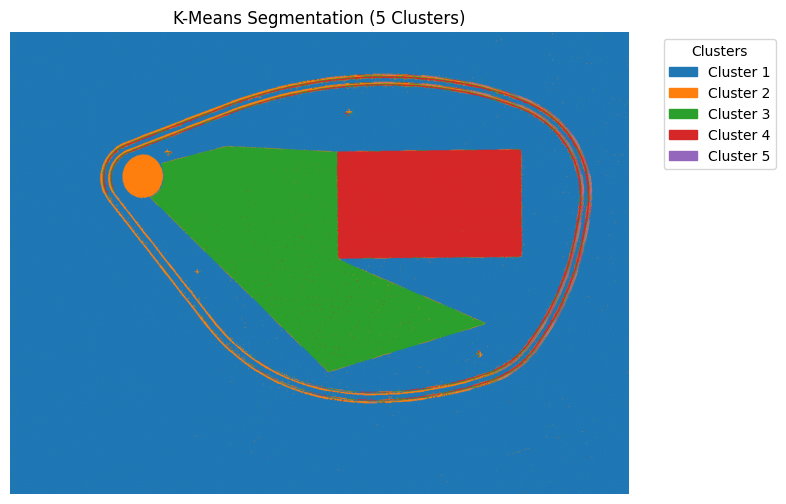

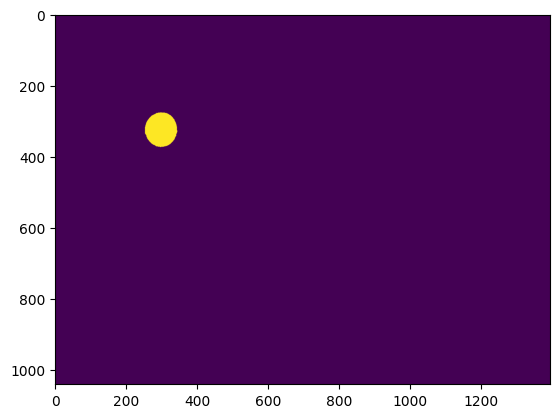

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


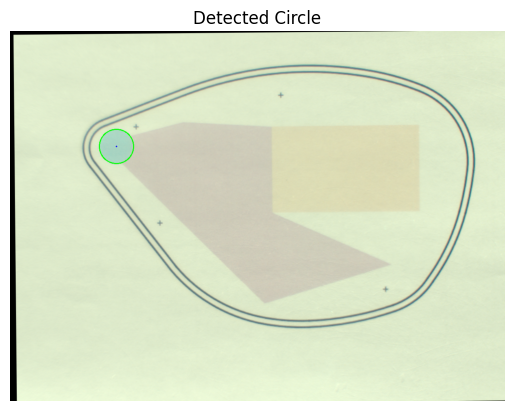

Processing d7...
[[ 1.00161016  0.00735103 -7.20804257]
 [-0.00735103  1.00161016  7.10862243]]


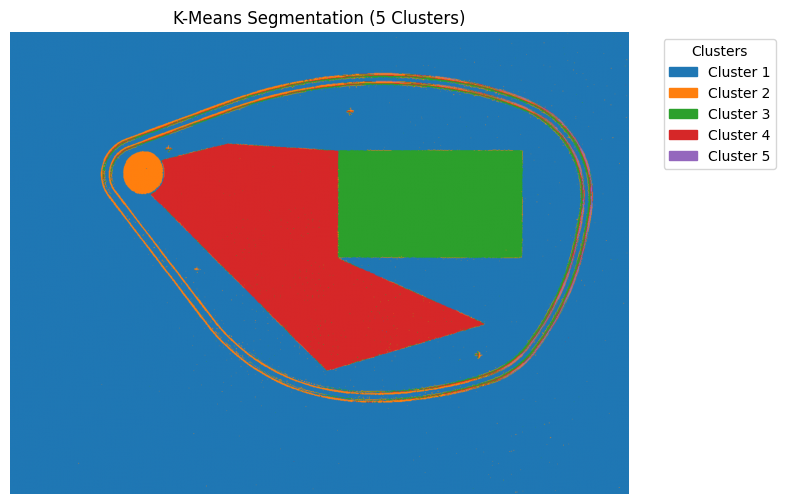

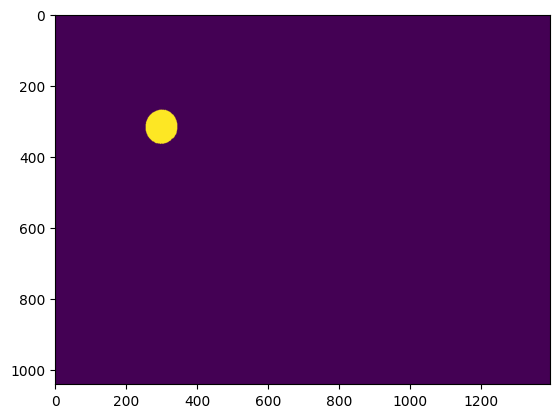

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


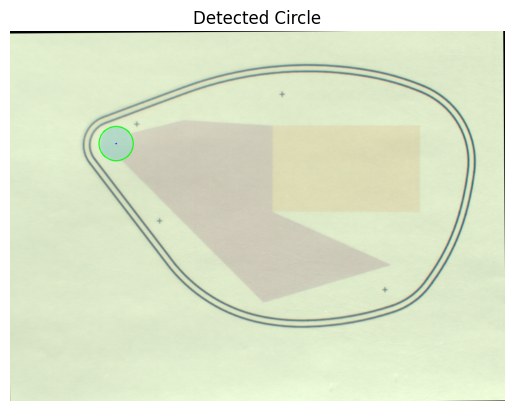

Processing d10...
[[ 1.00067668e+00  2.16570000e-03  2.22145915e+01]
 [-2.16570000e-03  1.00067668e+00 -1.14696782e+00]]


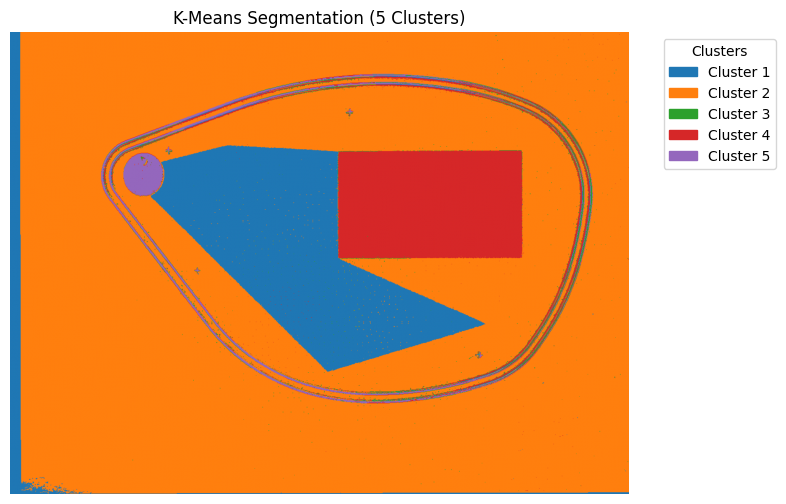

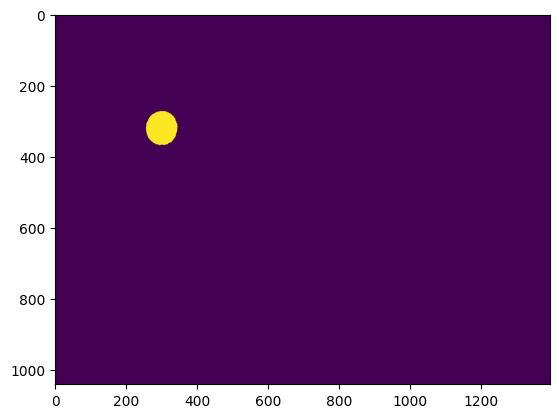

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


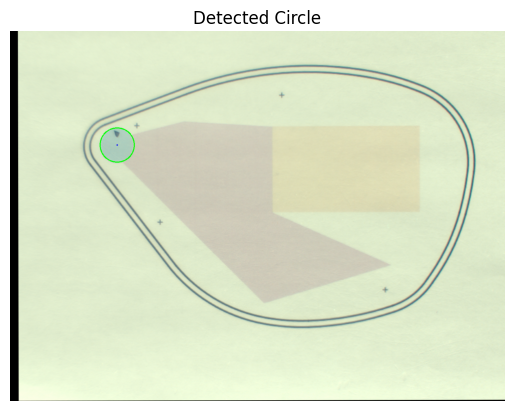

Processing d12...
[[ 9.99388715e-01 -3.98541830e-03 -2.00975672e+00]
 [ 3.98541830e-03  9.99388715e-01 -1.65996714e+01]]


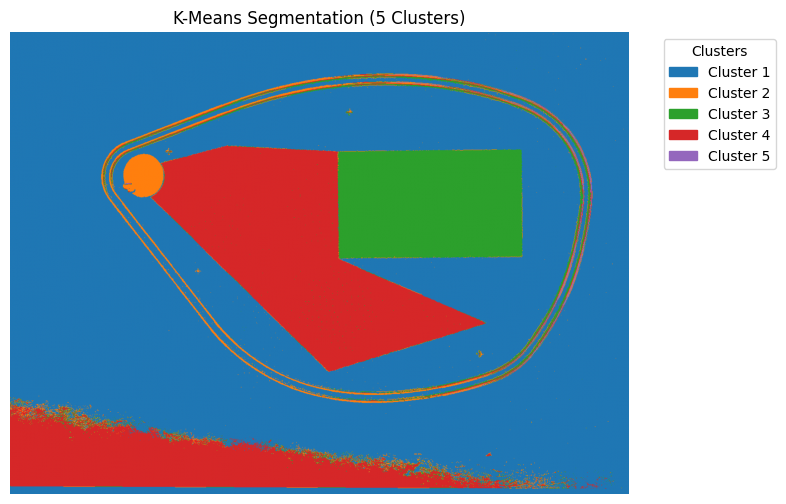

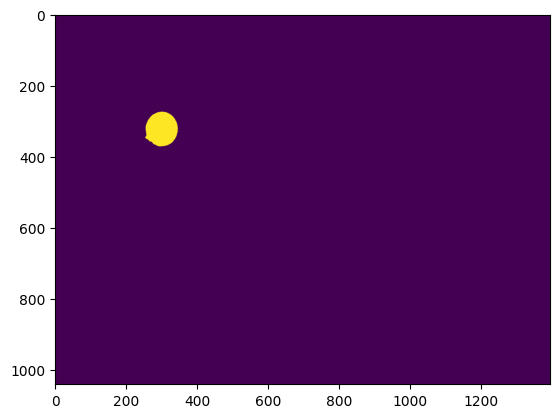

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


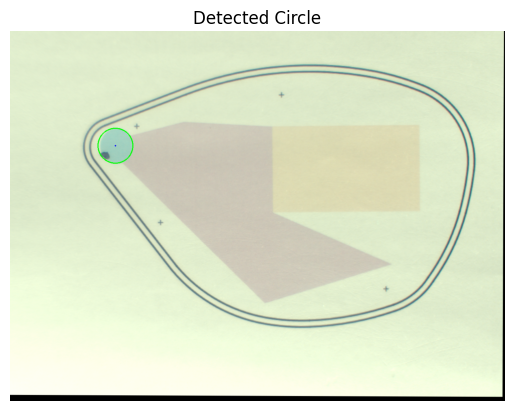

Processing d13...
[[ 1.00148809e+00  5.89966317e-03  7.86508233e+00]
 [-5.89966317e-03  1.00148809e+00  7.33072249e+00]]


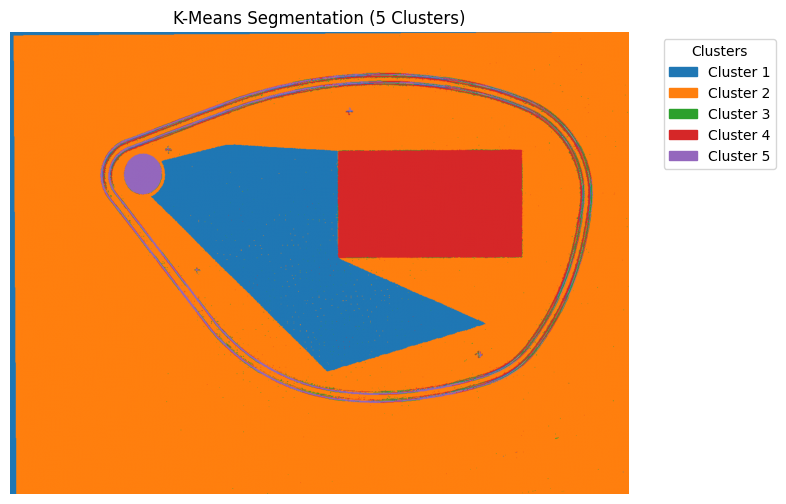

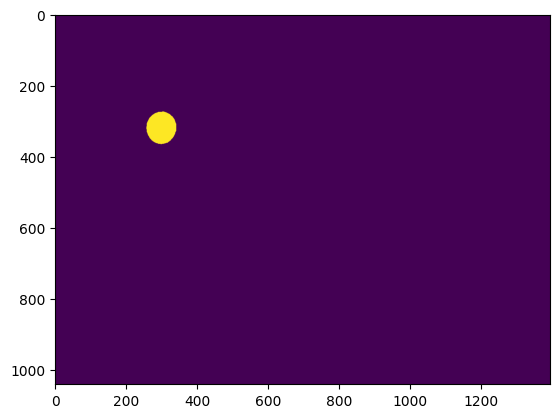

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


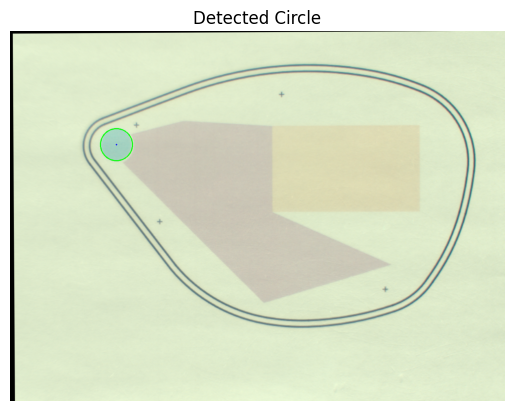

Processing d18...
[[ 1.00070661e+00  4.29971959e-05  8.66736641e+00]
 [-4.29971959e-05  1.00070661e+00  5.06459468e+00]]


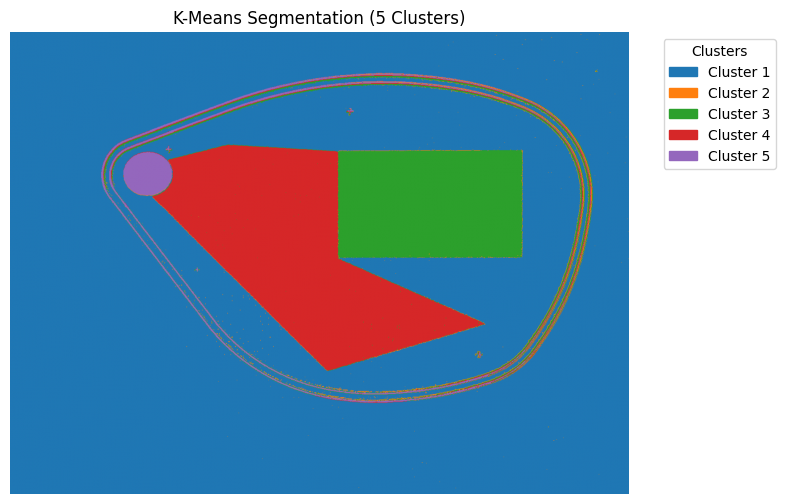

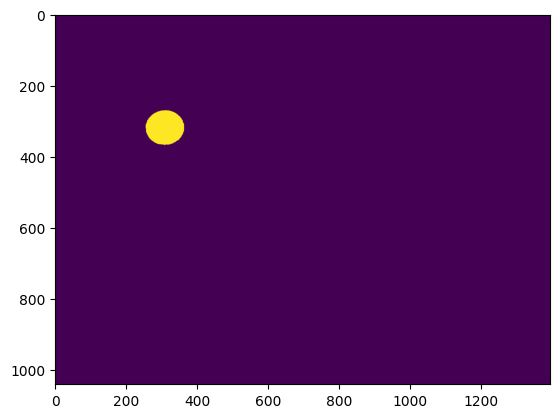

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


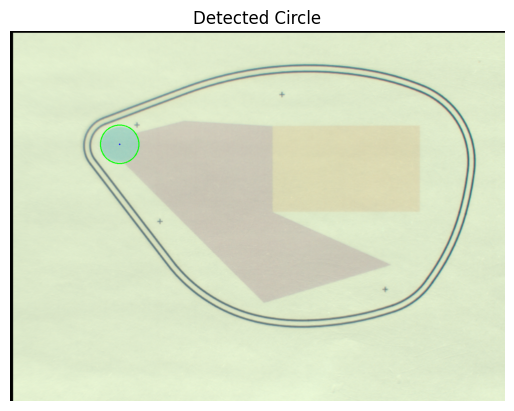

Processing d19...
[[ 9.99542698e-01  3.96555057e-03  7.09200505e+00]
 [-3.96555057e-03  9.99542698e-01  4.98680379e+00]]


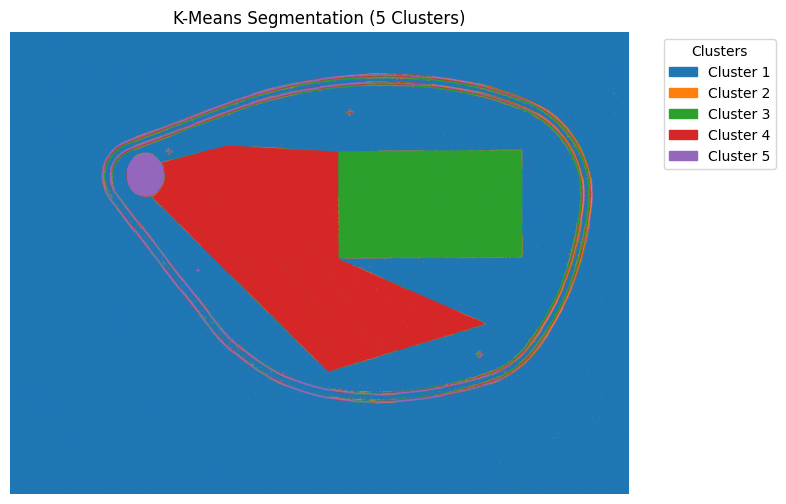

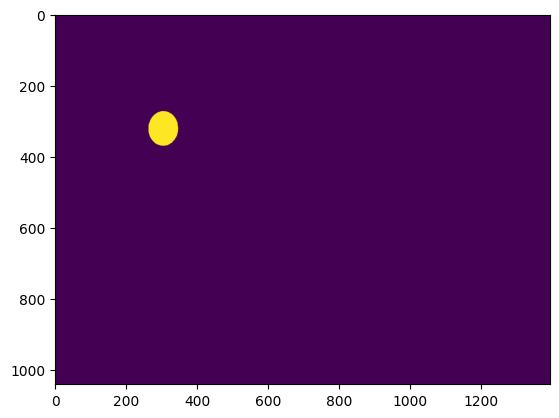

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


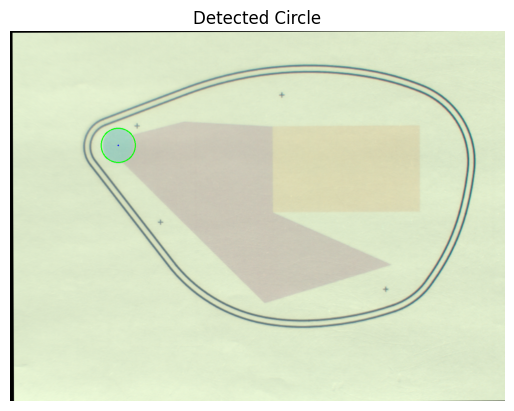

Processing d20...
[[ 9.95667712e-01  1.10330844e-02  1.80237857e+01]
 [-1.10330844e-02  9.95667712e-01  1.54848622e+01]]


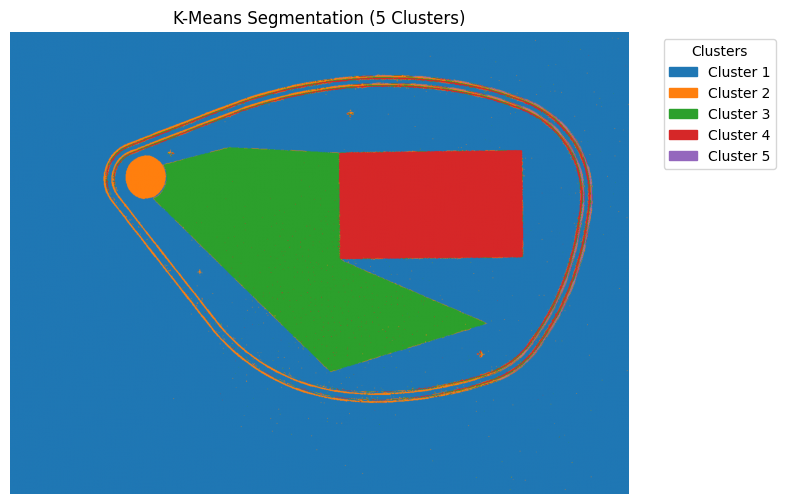

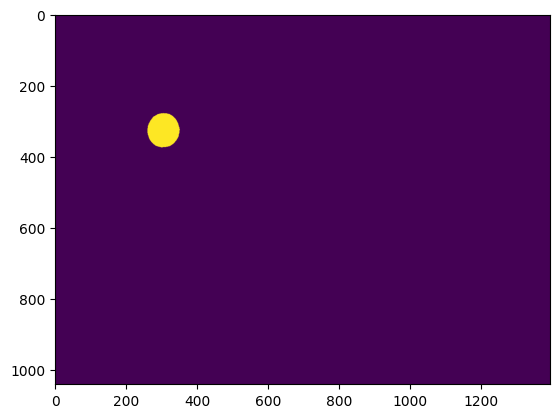

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


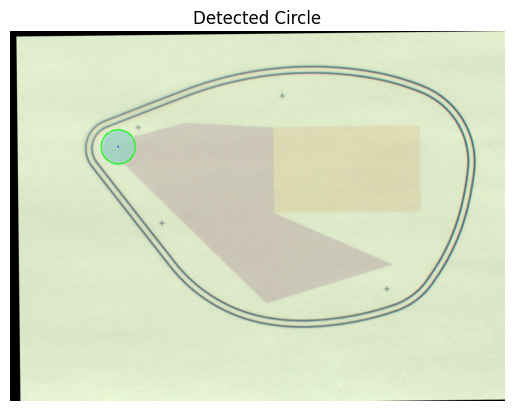

Processing d21...
[[ 9.98387581e-01  6.97517443e-03  7.11034246e+00]
 [-6.97517443e-03  9.98387581e-01  9.54914489e+00]]


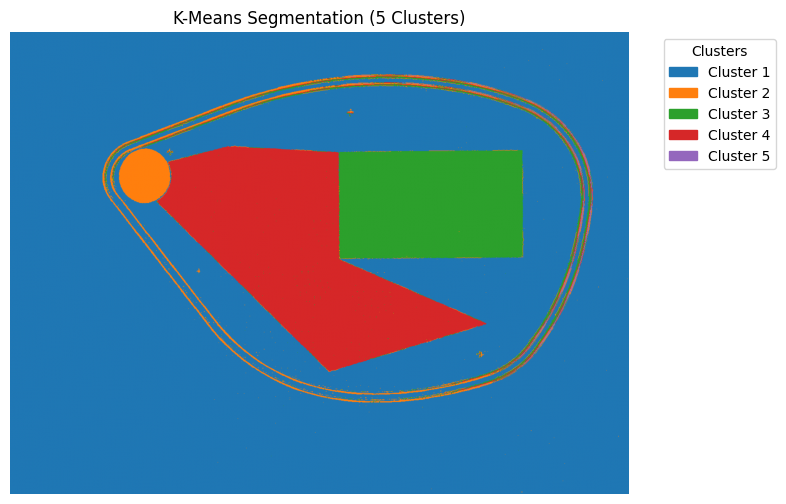

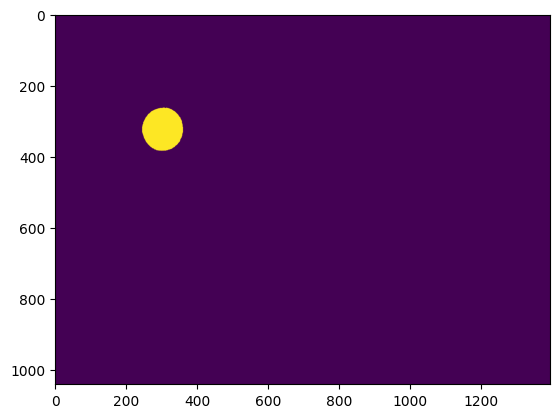

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


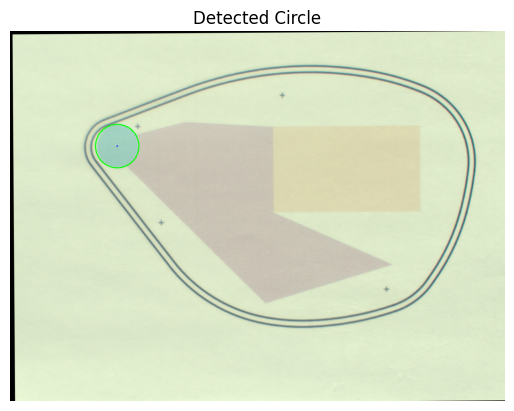

Processing d22...
[[ 1.00197203e+00  1.34781014e-02  1.41318950e+01]
 [-1.34781014e-02  1.00197203e+00  3.29593462e+00]]


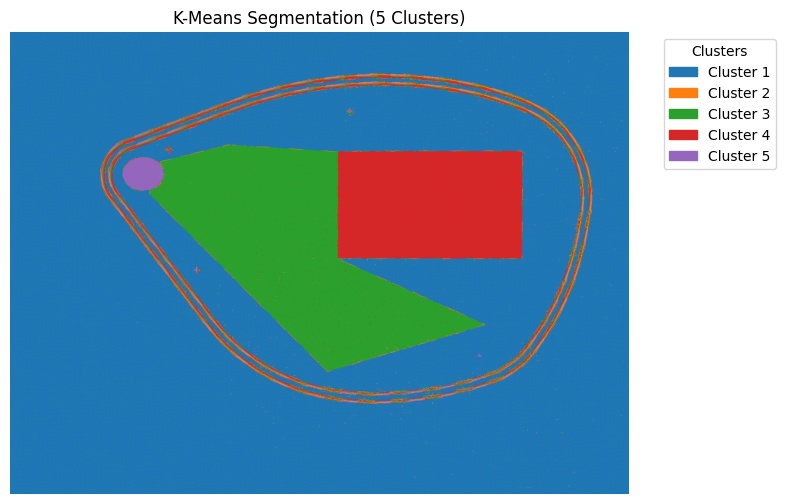

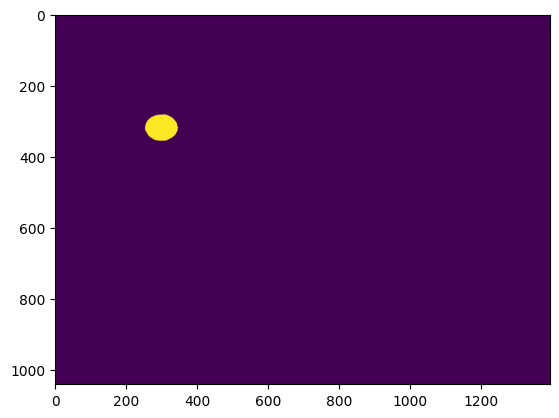

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


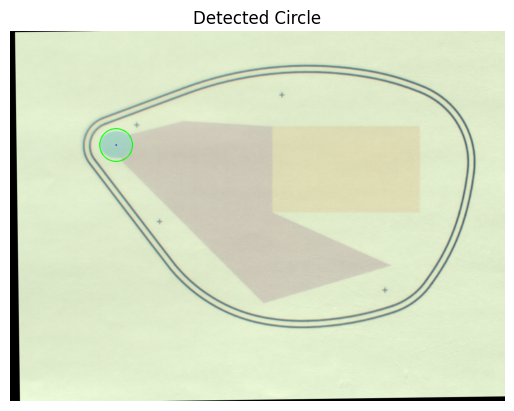

In [7]:
deltaE_results = []
defects_radius = []
defects_aligned = []

for i, defect_name in enumerate(defects):
    print(f"Processing {defect_name}...")

    # CTQ2 (in RGB)

    # Spectral to XYZ to RGB
    cube_interp, _ = interpolate_spectral_cube(
        defect_cubes[defect_name], wavelengths, wl_min=360, wl_max=830, wl_step=10
    )
    cube_interp = np.transpose(cube_interp, (1, 2, 0))  # (H, W, b)

    def_XYZ = spim2XYZ(cube_interp, new_wavelengths, "D65")
    rgb_vis = XYZ2RGB(def_XYZ)

    # Align defect
    A_3x3 = defect_homographies[i]
    print(A_3x3)
    A_2x3 = A_3x3[:2, :]
    defect_rgb = spim2rgb(defect_cubes[defect_name], wavelengths)
    h, w, b = defect_rgb.shape
    aligned_defect = cv2.warpAffine(defect_rgb, A_2x3, (w, h))
    defects_aligned.append(aligned_defect)

    # Compute defect mask of IC to find circle radius
    defect_mask = compute_IC_mask(defect_rgb, A_2x3, True, circle_center)
    defect_circle_info = get_circle_info(defect_mask, aligned_defect, True)
    defects_radius.append(defect_circle_info["min_enclosing_circle"]["radius"])

    # Masked CTQ for visualization
    aligned_vis = cv2.warpAffine(rgb_vis, A_2x3, (w, h))
    cropped_circle = crop_circle(aligned_vis, circle_center, circle_radius)
    cropped_circles.append(cropped_circle)

    # CTQ1 (all spectra)
    # Compute spectral average
    cube = defect_cubes[defect_name]
    bands, h, w = cube.shape

    # Align full cube
    cube_aligned = np.stack(
        [cv2.warpAffine(cube[j], A_3x3[:2, :], (w, h)) for j in range(bands)]
    )

    # Spectral to XYZ to LAB
    cube_interp, _ = interpolate_spectral_cube(
        cube_aligned, wavelengths, wl_min=360, wl_max=830, wl_step=10
    )
    cube_interp = np.transpose(cube_interp, (1, 2, 0))  # (H, W, b)

    def_XYZ = spim2XYZ(cube_interp, new_wavelengths, "D65")
    def_LAB = XYZ2Lab(def_XYZ, new_wavelengths, "D65")

    # CIelab delta E with reference
    DE_mean = calculate_delta_E(ref_LAB, def_LAB, mask=mask_ref)
    deltaE_results.append(DE_mean)

In [8]:
defects_radius

[48.813472747802734,
 48.85959243774414,
 48.50783157348633,
 48.25548553466797,
 49.530113220214844,
 45.74858474731445,
 54.24644470214844,
 48.690773010253906,
 48.402587890625,
 61.288352966308594,
 46.10055923461914]

7. Create df to save results


In [9]:
# Save results to df
result_df = pd.DataFrame()
result_df["defect_id"] = defects
result_df["DE_mean"] = deltaE_results
result_df["D_radius"] = abs(np.array(defects_radius) - circle_radius)

result_df["CTQ1"] = np.array(deltaE_results) > 2.8
result_df["CTQ2"] = (
    abs(np.array(defects_radius) - circle_radius) > 1.2
)  # new reference  50

result_df["Defect?"] = result_df["CTQ1"] | result_df["CTQ2"]

if test:
    result_df.to_csv(f"deltaE_results_test{trial}_operator{operator}.csv", index=False)
else:
    result_df.to_csv("deltaE_results_train.csv", index=False)
print("\nAverage DE (CIE2000) values per defect:")
print(result_df)


Average DE (CIE2000) values per defect:
   defect_id   DE_mean   D_radius   CTQ1   CTQ2  Defect?
0         d3  5.939509   0.425838   True  False     True
1         d4  1.593297   0.379719  False  False    False
2         d7  2.711773   0.731480  False  False    False
3        d10  4.962837   0.983826   True  False     True
4        d12  2.589264   0.290802  False  False    False
5        d13  1.715201   3.490726  False   True     True
6        d18  1.690342   5.007133  False   True     True
7        d19  2.005985   0.548538  False  False    False
8        d20  1.836987   0.836723  False  False    False
9        d21  2.079663  12.049042  False   True     True
10       d22  2.762438   3.138752  False   True     True


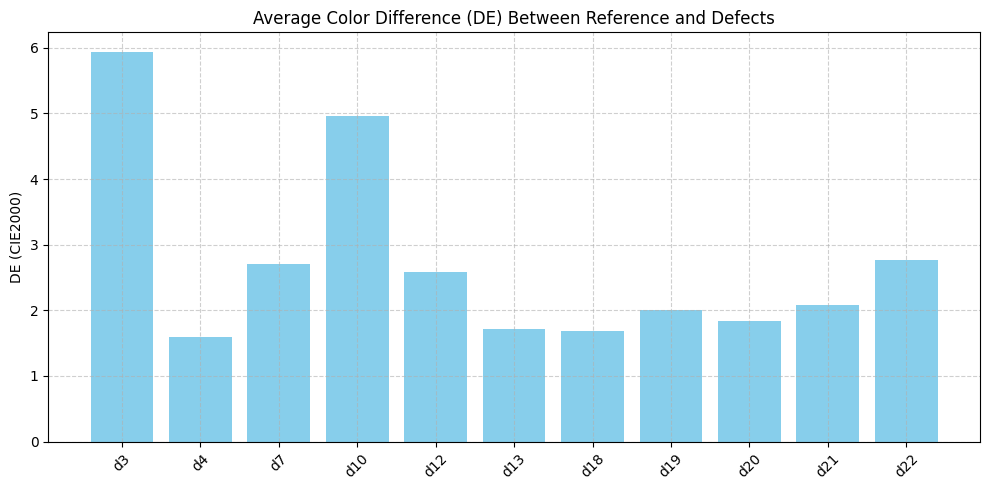

In [10]:
# Plot delta E differences
plt.figure(figsize=(10, 5))
plt.bar(result_df["defect_id"], result_df["DE_mean"], color="skyblue")
plt.ylabel("DE (CIE2000)")
plt.title("Average Color Difference (DE) Between Reference and Defects")
plt.xticks(rotation=45)
plt.grid(True, linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

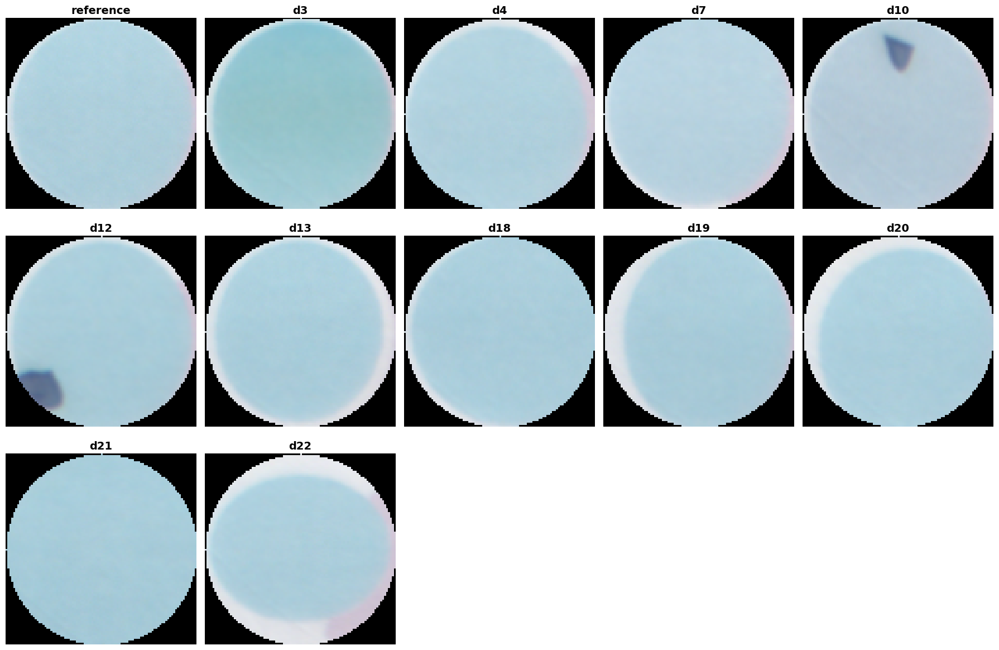

In [11]:
# Plot masked IC region
titles = ["reference"] + defects
plt.figure(figsize=(18, 12))
cols = 5
rows = math.ceil((len(defects) + 1) / cols)
for idx, (img, title) in enumerate(zip(cropped_circles, titles)):
    plt.subplot(rows, cols, idx + 1)
    if img.ndim == 2:
        plt.imshow(img, cmap="gray")
    else:
        plt.imshow(img)
    plt.title(title, fontsize=14, fontweight="bold")
    plt.axis("off")

# plt.suptitle(
#     "Detected IC Region (Reference + 14 Aligned Defects)",
#     fontsize=18,
#     fontweight="bold",
# )
plt.tight_layout()
plt.show()

6. Average reflectance in Circle


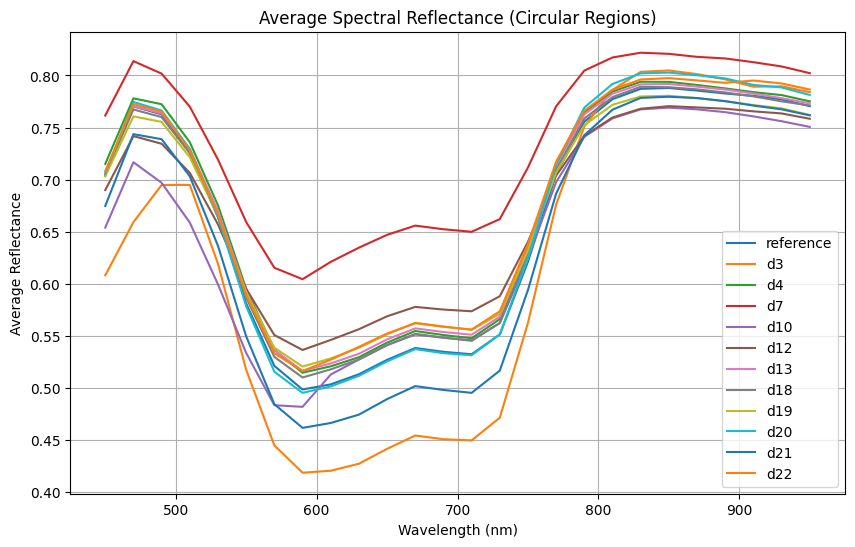

In [12]:
# Plot average spectra of each defect
for defect_name in defects:
    cube = defect_cubes[defect_name]
    spec = average_reflectance_in_circle(
        cube, circle_center, circle_radius, transform=A_3x3
    )
    spectra[defect_name] = spec
plt.figure(figsize=(10, 6))
for name, spectrum in spectra.items():
    # if name == "reference" or name == "d4":
    #     plt.plot(wavelengths, spectrum, label=name)
    plt.plot(wavelengths, spectrum, label=name)

plt.xlabel("Wavelength (nm)")
plt.ylabel("Average Reflectance")
plt.title("Average Spectral Reflectance (Circular Regions)")
plt.legend()
plt.grid(True)
plt.show()

In [13]:
def std_reflectance_in_circle(hypercube, center, radius, transform=None):
    bands, h, w = hypercube.shape

    hypercube_aligned = np.stack(
        [cv2.warpAffine(hypercube[i], transform, (w, h)) for i in range(bands)]
    )

    mask = np.zeros((h, w), dtype=np.uint8)
    cx, cy = int(round(center[0])), int(round(center[1]))
    r = int(radius) - 5
    cv2.circle(mask, (cx, cy), r, 1, -1)

    std_reflectance = []
    for i in range(bands):
        band = hypercube_aligned[i]
        masked_pixels = band[mask == 1]
        if masked_pixels.size > 0:
            std_reflectance.append(np.std(masked_pixels))
        else:
            std_reflectance.append(np.nan)

    return np.array(std_reflectance)


new_spectra = {}
new_spectra_std = {}

for defect_name, transform in zip(defects, defect_homographies):
    cube = defect_cubes[defect_name]
    new_spectra[defect_name] = average_reflectance_in_circle(
        cube, circle_center, circle_radius, transform=transform
    )
    new_spectra_std[defect_name] = std_reflectance_in_circle(
        cube, circle_center, circle_radius, transform=transform
    )


for defect_name in defects:
    std_values = new_spectra_std[defect_name]
    mean_values = new_spectra[defect_name]

    print(
        f"{defect_name}: Mean Std across wavelengths = {np.nanmean(std_values):.6f}, Coefficient of Variation (mean) = {np.nanmean(std_values/mean_values)*100:.2f}%"
    )

d3: Mean Std across wavelengths = 0.018752, Coefficient of Variation (mean) = 3.34%
d4: Mean Std across wavelengths = 0.016979, Coefficient of Variation (mean) = 2.62%
d7: Mean Std across wavelengths = 0.016973, Coefficient of Variation (mean) = 2.47%
d10: Mean Std across wavelengths = 0.058937, Coefficient of Variation (mean) = 9.42%
d12: Mean Std across wavelengths = 0.069452, Coefficient of Variation (mean) = 11.19%
d13: Mean Std across wavelengths = 0.025625, Coefficient of Variation (mean) = 4.16%
d18: Mean Std across wavelengths = 0.013853, Coefficient of Variation (mean) = 2.20%
d19: Mean Std across wavelengths = 0.031088, Coefficient of Variation (mean) = 5.28%
d20: Mean Std across wavelengths = 0.031985, Coefficient of Variation (mean) = 5.26%
d21: Mean Std across wavelengths = 0.016494, Coefficient of Variation (mean) = 2.64%
d22: Mean Std across wavelengths = 0.042212, Coefficient of Variation (mean) = 6.98%


In [14]:
avg_std_per_defect = {
    name: np.nanmean(std_values) for name, std_values in new_spectra_std.items()
}

sorted_defects = sorted(avg_std_per_defect.items(), key=lambda x: x[1], reverse=True)
for rank, (name, std_val) in enumerate(sorted_defects, 1):
    print(f"{name}: {std_val:.6f}")

d12: 0.069452
d10: 0.058937
d22: 0.042212
d20: 0.031985
d19: 0.031088
d13: 0.025625
d3: 0.018752
d4: 0.016979
d7: 0.016973
d21: 0.016494
d18: 0.013853
